# IPCV Assignment 1

Authors:

- Mauro Dore             - mauro.dore@studio.unibo.it            - 0001105149
- Gian Mario Marongiu    - gianmario.marongiu@studio.unibo.it    - 0001092260
- Riccardo Murgia        - riccardo.murgia2@studio.unibo.it      - 0001083930

## Imports and Auxiliary Functions

In [2]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
from sklearn.metrics import precision_score, recall_score, f1_score


In [3]:
def show_multiple_images(image_list, cols=3, titles=None, global_title=None, plot_height=3):
    if not image_list:
        raise ValueError("The image list must not be empty.")

    num_images = len(image_list)
    
    if titles and len(titles) != num_images:
        raise ValueError("Titles list length must match the number of images.")
    
    rows = -(-num_images // cols)  # Equivalent to math.ceil

    fig, axes = plt.subplots(rows, cols, figsize=(10, plot_height * rows))
    fig.subplots_adjust(top=0.9 if global_title else 1.0)
    
    if global_title:
        fig.suptitle(global_title, fontsize=16, fontweight='bold')
    
    axes = axes.flatten() if num_images > 1 else [axes]
    
    for i, ax in enumerate(axes):
        if i < num_images:
            ax.imshow(cv2.cvtColor(image_list[i], cv2.COLOR_BGR2RGB))
            ax.set_axis_off()
            if titles:
                ax.set_title(titles[i], fontsize=12, fontweight='bold')
        else:
            ax.set_visible(False)
    
    plt.tight_layout()
    plt.show()

def compute_metrics(real_occurrences, predicted_occurrences):
    # Initialize variables to track TP, FP, FN
    true_positives = 0
    false_positives = 0
    false_negatives = 0

    # Iterate over each class/key in real occurrences
    for key in real_occurrences:
        real_set = set(real_occurrences[key])
        predicted_set = set(predicted_occurrences.get(key, []))

        # Compute true positives (correct predictions)
        tp = len(real_set & predicted_set)

        # Compute false positives (wrong predictions)
        fp = len(predicted_set - real_set)

        # Compute false negatives (missed real occurrences)
        fn = len(real_set - predicted_set)

        # Update counts
        true_positives += tp
        false_positives += fp
        false_negatives += fn

    # Calculate precision, recall, and F1 score
    precision = true_positives / (true_positives + false_positives) if true_positives + false_positives > 0 else 0
    recall = true_positives / (true_positives + false_negatives) if true_positives + false_negatives > 0 else 0
    f1 = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0

    # Return the metrics
    return precision, recall, f1
    
def png_to_numpy(path, list):
    for image_name in os.listdir(path):
        image_path = os.path.join(path, image_name)
        image = cv2.imread(image_path)
        list.append(image)

def print_detection_summary(real_matchings, detected_matchings):
    print("Detection summary:")
    for scene in real_matchings.keys():
        scene_str = f"Scene {scene}".ljust(20)
        present_models_str = f"Models in the image: {real_matchings[scene]}".ljust(60)
        detected_models_str = f"Models detected: {detected_matchings[scene]}"
    
        print(f"{scene_str} {present_models_str} {detected_models_str}")


In [4]:
MODELS_SINGLE_INSTANCE_PATH = "models_single_instance"
SCENES_SINGLE_INSTANCE_PATH = "scenes_single_instance"
MODELS_MULTIPLE_INSTANCES_PATH = "models_multiple_instances"
SCENES_MULTIPLE_INSTANCES_PATH = "scenes_multiple_instances"

models_single_instance = []
scenes_single_instance = []
models_multiple_instances = []
scenes_multiple_instances = []

png_to_numpy(MODELS_SINGLE_INSTANCE_PATH, models_single_instance)
png_to_numpy(SCENES_SINGLE_INSTANCE_PATH, scenes_single_instance)
png_to_numpy(MODELS_MULTIPLE_INSTANCES_PATH, models_multiple_instances)
png_to_numpy(SCENES_MULTIPLE_INSTANCES_PATH, scenes_multiple_instances)
    
print(f"{len(models_single_instance)} models and {len(scenes_single_instance)} scenes for single instance detection task")
print(f"{len(models_multiple_instances)} models and {len(scenes_multiple_instances)} scenes for multiple instances detection task")


14 models and 5 scenes for single instance detection task
12 models and 7 scenes for multiple instances detection task


## Task Analysis

The objective is to perform instance detection using the provided model images. Several challenges must be addressed:

- The scenes contain significant noise, which must be mitigated prior to detection;
- The models are noticeably brighter than the scenes, indicating the need for a method that is robust to intensity variations;
- The models and scenes exhibit considerable variation in shape, necessitating the use of a scale-invariant detector.

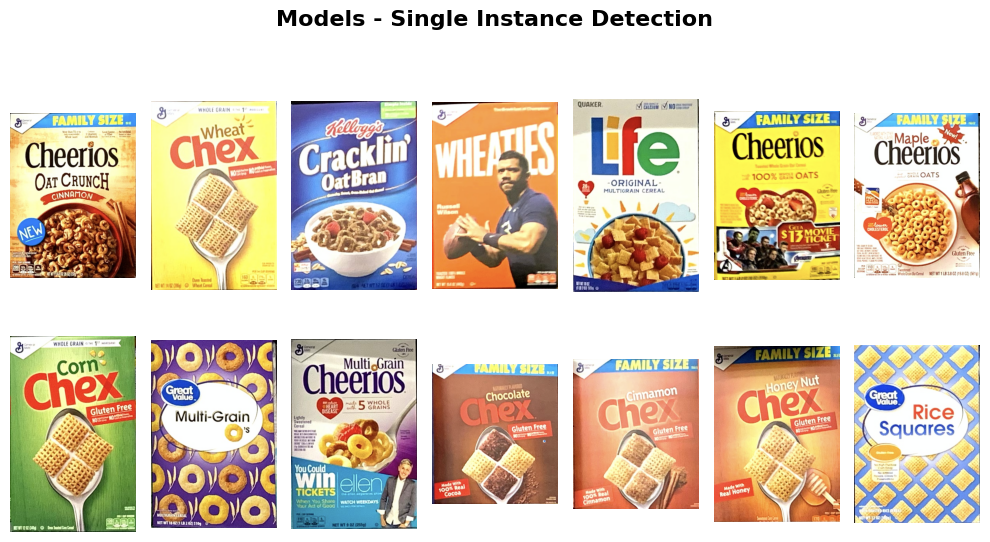

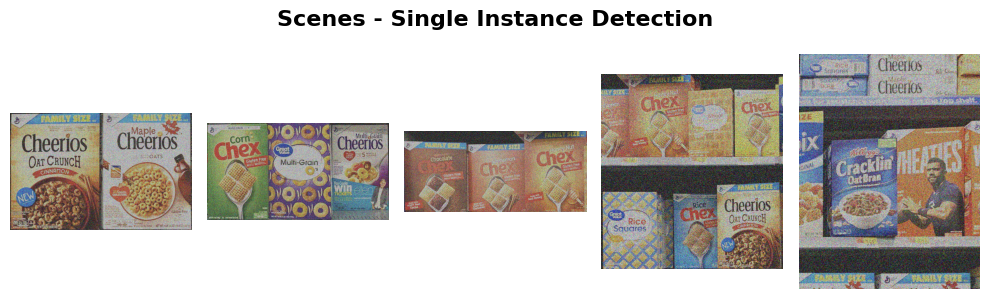

In [5]:
single_instance_real_matchings = {0: [0, 6], 1: [7, 8, 9], 2: [10, 11, 12], 3: [11, 12, 13, 1, 0], 4: [2, 3, 6]}
show_multiple_images(models_single_instance, cols=7, global_title="Models - Single Instance Detection")
show_multiple_images(scenes_single_instance, cols=5, global_title="Scenes - Single Instance Detection")


## Scenes Denoising

Single Detection Scenes Denoising: 100%|██████████| 5/5 [00:01<00:00,  4.21it/s]


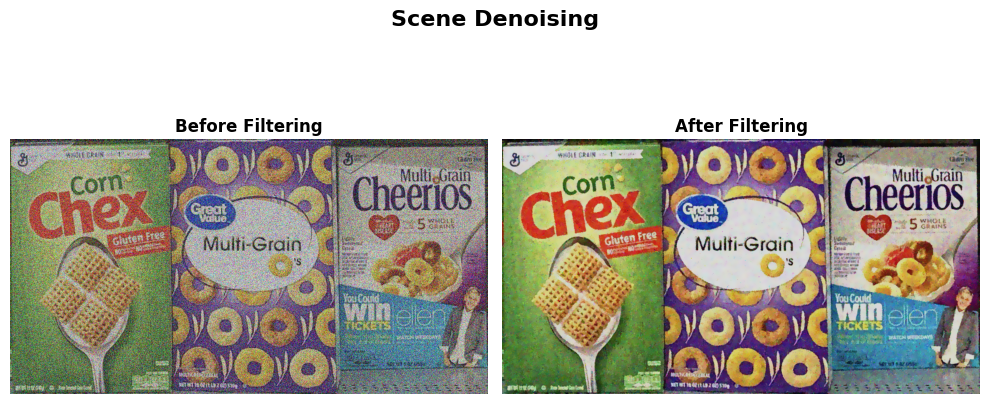

In [6]:
denoised_scenes_single_instance = []

#sigma = 2
#k_size = int(np.ceil((3*sigma))*2 + 1) #rule of thumb for a good kernel size given sigma

for scene in tqdm(scenes_single_instance, desc="Single Detection Scenes Denoising: "):
    #denoised_scene = cv2.GaussianBlur(scene, (k_size,k_size) , sigma)
    denoised_scene = cv2.medianBlur(scene, 3)
    denoised_scene = cv2.medianBlur(denoised_scene, 3)
    denoised_scene = cv2.bilateralFilter(denoised_scene, d=19, sigmaColor=50, sigmaSpace=250)
    #denoised_scene = cv2.bilateralFilter(denoised_scene, d=19, sigmaColor=35, sigmaSpace=250)
    denoised_scene = cv2.bilateralFilter(denoised_scene, d=19, sigmaColor=20, sigmaSpace=100)
    #denoised_scene = cv2.fastNlMeansDenoisingColored(denoised_scene, dst=None, h=3, hColor=3, templateWindowSize=7, searchWindowSize=21)
    denoised_scenes_single_instance.append(denoised_scene)
    
# example of a random denoised image
random_idx = np.random.randint(len(scenes_single_instance))
show_multiple_images([scenes_single_instance[random_idx], denoised_scenes_single_instance[random_idx]],
                     global_title=f"Scene Denoising",
                     titles=["Before Filtering", "After Filtering"],
                     cols=2,
                     plot_height=5)


## Single Instance Detection

In [7]:
def warp_model(model, homography, scene_shape):
    """
    Warps the entire model to the scene based on the homography matrix.
    Ensures that the warped model stays within the scene boundaries.
    """
    height, width = model.shape[:2]

    # Get the corner points of the model
    model_corners = np.float32([[0, 0], [0, height - 1], [width - 1, height - 1], [width - 1, 0]]).reshape(-1, 1, 2)

    # Warp the corner points to the scene using the homography matrix
    warped_corners = cv2.perspectiveTransform(model_corners, homography)

    # Get the bounding box of the warped model
    x_min = int(min(warped_corners[:, 0, 0]))
    x_max = int(max(warped_corners[:, 0, 0]))
    y_min = int(min(warped_corners[:, 0, 1]))
    y_max = int(max(warped_corners[:, 0, 1]))

    # Ensure the bounding box is within the scene boundaries
    h_scene, w_scene = scene_shape[:2]
    x_min = max(0, x_min)
    x_max = min(w_scene, x_max)
    y_min = max(0, y_min)
    y_max = min(h_scene, y_max)

    # Warp the entire model to the scene size using homography
    warped_model = cv2.warpPerspective(model, homography, (w_scene, h_scene))

    # Crop the corresponding region from the warped model and scene
    return warped_model[y_min:y_max, x_min:x_max], (x_min, y_min, x_max, y_max)

def zncc(patch1, patch2):
    # Subtract the mean from each patch (Zero mean)
    patch1_mean = patch1 - np.mean(patch1)
    patch2_mean = patch2 - np.mean(patch2)

    # Compute the numerator: sum of element-wise products of the zero-mean patches
    numerator = np.sum(patch1_mean * patch2_mean)

    # Compute the denominator: product of the standard deviations
    denominator = np.sqrt(np.sum(patch1_mean ** 2) * np.sum(patch2_mean ** 2))

    # Avoid division by zero
    if denominator == 0:
        return -1  # Return -1 if denominator is 0

    return numerator / denominator

def validate_matching(model, scene, homography, config):
    """
    Validate by comparing the entire warped model with the corresponding region in the scene.
    """
    # Warp the model and get the corresponding region in the scene
    model_warped, (x_min, y_min, x_max, y_max) = warp_model(model, homography, scene.shape)

    # Extract the corresponding region from the scene
    scene_region = scene[y_min:y_max, x_min:x_max]

    # Compare the entire warped model and the scene region using ZNCC
    zncc_score = zncc(model_warped, scene_region)
    return zncc_score > config["zncc_threshold"]


def object_retrieve(model, scene, config):
    sift = cv2.SIFT_create(contrastThreshold=config["sift_contrast_threshold"],
                           edgeThreshold=config["sift_edge_threshold"],
                           sigma=config["sift_sigma"],
                           nOctaveLayers=config["sift_n_octave_layers"])

    # Detect keypoints and compute descriptors
    keypoints_model, descriptors_model = sift.detectAndCompute(model, None)
    keypoints_scene, descriptors_scene = sift.detectAndCompute(scene, None)

    # FLANN parameters for matching
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=config["flann_trees"])
    search_params = dict(checks=config["flann_checks"])
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    # Match descriptors using k-NN (k=2)
    matches = flann.knnMatch(descriptors_model, descriptors_scene, k=2)

    # Lowe's ratio test to select good matches. m is first match, n is second match.
    good_matches = []
    for model_point, scene_point in matches:
        if model_point.distance < config["lowes_ratio_thresh"] * scene_point.distance:
            good_matches.append(model_point)

    # Ensure enough good matches were found
    if len(good_matches) < config["low_thresh_min_match"]:
        return False, scene, len(good_matches)

    # Extract coordinates from the good matches
    src_pts = np.float32([keypoints_model[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([keypoints_scene[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    # Find homography matrix
    homography, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

    # Validate using zncc
    matching_exceeds_high_threshold = len(good_matches) > config["high_thresh_min_match"]
    matching_exceeds_low_threshold = len(good_matches) > config["low_thresh_min_match"]
    patch_check_is_valid = validate_matching(model, scene, homography, config)

    if matching_exceeds_high_threshold or (matching_exceeds_low_threshold and patch_check_is_valid):
        height, width = model.shape[:2]
        model_corners = np.float32([[0, 0], [0, height - 1], [width - 1, height - 1], [width - 1, 0]]).reshape(-1, 1, 2)
        dst = cv2.perspectiveTransform(model_corners, homography)
        scene_boxed = cv2.polylines(np.array(scene), [np.int32(dst)], True, (0, 255, 0), 5, cv2.LINE_AA)

        return True, scene_boxed, len(good_matches)
    else:
        return False, scene, len(good_matches)


In [11]:
config_single_instance = {
    # sift parameters
    "sift_contrast_threshold": 0.03,
    "sift_edge_threshold": 15,
    "sift_sigma": 1.5,
    "sift_n_octave_layers": 4,

    # flann parameters
    "flann_trees": 12,
    "flann_checks": 80,

    # feature matching parameters
    "low_thresh_min_match": 15,
    "high_thresh_min_match": 200,
    "lowes_ratio_thresh": 0.65,

    # Zero normalized cross-correlation parameters
    "zncc_threshold": 0.6,
}

single_model_scene_couples = []
single_instance_detected_matchings = {scene: [] for scene in range(len(scenes_single_instance))}

total_iterations = len(models_single_instance) * len(denoised_scenes_single_instance)
with tqdm(total=total_iterations, desc="Processing Models and Scenes") as pbar:
    for model_idx, model in enumerate(models_single_instance):
        for scene_idx, scene in enumerate(denoised_scenes_single_instance):
            found, scene_boxed, good_matches = object_retrieve(model=model, scene=scene, config=config_single_instance)
            single_model_scene_couples.append([model, scene_boxed, found, good_matches])

            if found:
                single_instance_detected_matchings[scene_idx].append(model_idx)

            pbar.update(1)

print_detection_summary(single_instance_real_matchings, single_instance_detected_matchings)


Processing Models and Scenes: 100%|██████████| 70/70 [01:05<00:00,  1.08it/s]

Detection summary:
Scene 0              Models in the image: [0, 6]                                  Models detected: [0, 6]
Scene 1              Models in the image: [7, 8, 9]                               Models detected: [7, 8, 9]
Scene 2              Models in the image: [10, 11, 12]                            Models detected: [10, 11, 12]
Scene 3              Models in the image: [11, 12, 13, 1, 0]                      Models detected: [0, 1, 11, 12, 13]
Scene 4              Models in the image: [2, 3, 6]                               Models detected: [2, 3, 6]


In [8]:
PLOT_ALL_IMAGES = False

if PLOT_ALL_IMAGES:
    for model, scene, found, good_matches in single_model_scene_couples:
        show_multiple_images([model, scene], cols=2, global_title=f"{good_matches} good matches")


## Multiple Instances Detection

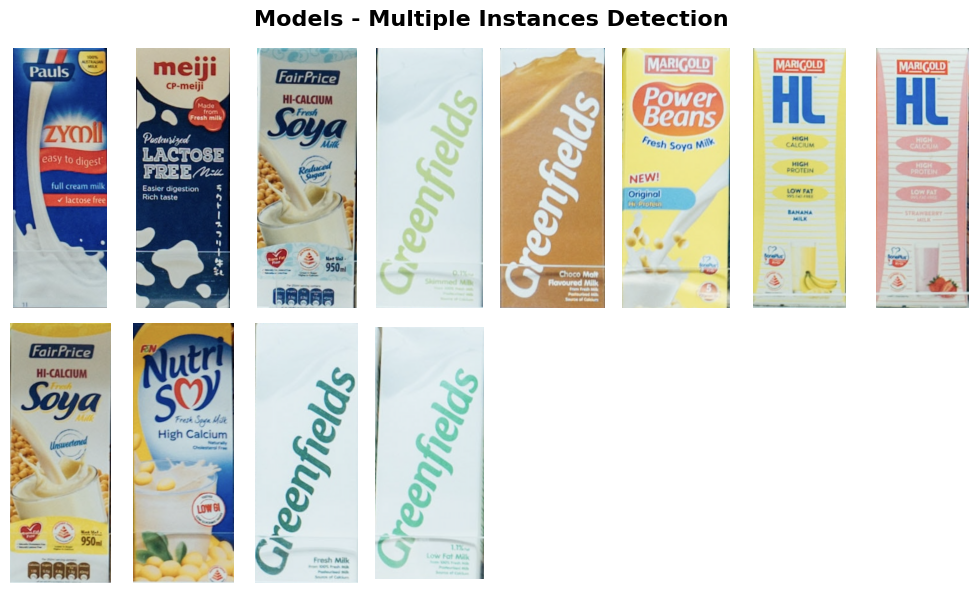

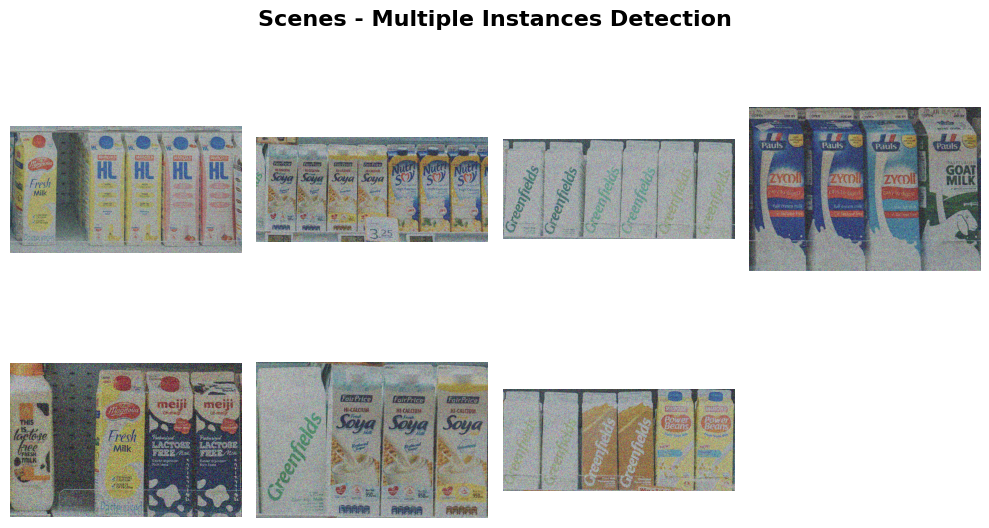

In [8]:
# {scene_idx: (model_idx, n_occurrences)}
multi_instance_real_matchings = {0: [(6, 2), (7, 2)],
                                 1: [(2, 2), (8, 2), (9, 3)], 
                                 2: [(10, 2), (11, 2), (3, 2)], 
                                 3: [(0, 2)], 
                                 4: [(1, 2)], 
                                 5: [(11, 1), (2, 2), (8, 1)],
                                 6: [(3, 2), (4, 2), (5, 2)]}

show_multiple_images(models_multiple_instances, cols=8, global_title="Models - Multiple Instances Detection")
show_multiple_images(scenes_multiple_instances, cols=4, global_title="Scenes - Multiple Instances Detection")


Multiple Detection Scenes Denoising: 100%|██████████| 7/7 [00:01<00:00,  4.39it/s]


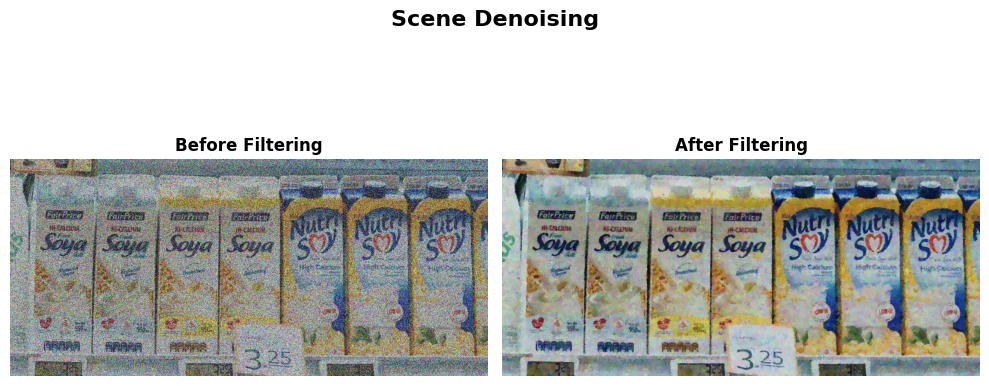

In [9]:
denoised_scenes_multiple_instances = []

for scene in tqdm(scenes_multiple_instances, desc="Multiple Detection Scenes Denoising: "):
    denoised_scene = cv2.medianBlur(scene, 3)
    denoised_scene = cv2.medianBlur(denoised_scene, 3)
    denoised_scene = cv2.bilateralFilter(denoised_scene, d=19, sigmaColor=50, sigmaSpace=250)
    denoised_scene = cv2.bilateralFilter(denoised_scene, d=19, sigmaColor=20, sigmaSpace=100)
    denoised_scenes_multiple_instances.append(denoised_scene)

# example of denoised image
random_idx = np.random.randint(len(scenes_multiple_instances))
show_multiple_images([scenes_multiple_instances[random_idx], denoised_scenes_multiple_instances[random_idx]],
                     global_title=f"Scene Denoising",
                     titles=["Before Filtering", "After Filtering"],
                     cols=2,
                     plot_height=5)

In [11]:
"""def star_model(model, scene, config):
    sift = cv2.SIFT_create(
        contrastThreshold=config["sift_contrast_threshold"],
        edgeThreshold=config["sift_edge_threshold"],
        sigma=config["sift_sigma"],
        nOctaveLayers=config["sift_n_octave_layers"]
    )

    # Off-line phase
    keypoints_model, descriptors_model = sift.detectAndCompute(model, None)
    model_centroid = np.mean([kp.pt for kp in keypoints_model], axis=0)

    # Define the scale range
    scale_range = np.linspace(config["min_scale"], config["max_scale"], num=config["n_scales"])

    # Online phase
    keypoints_scene, descriptors_scene = sift.detectAndCompute(scene, None)
    accumulator_array = np.zeros((scene.shape[0], scene.shape[1], len(scale_range)))

    # FLANN parameters for matching
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=config["flann_trees"])
    search_params = dict(checks=config["flann_checks"])
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    # Match descriptors using k-NN (k=2)
    matches = flann.knnMatch(descriptors_model, descriptors_scene, k=2)

    # Apply Lowe's ratio test to select good matches
    good_matches = []
    for m, n in matches:
        if m.distance < config["lowes_ratio_thresh"] * n.distance:
            good_matches.append(m)

    # Ensure there are good matches
    if len(good_matches) == 0:
        print("No good matches found")
        return None, None, None

    # Voting in the accumulator array using descriptor scale information
    for match in good_matches:
        model_idx = match.queryIdx
        scene_idx = match.trainIdx

        kp_model = keypoints_model[model_idx]
        kp_scene = keypoints_scene[scene_idx]

        # Compute the scale ratio using keypoint sizes
        scale_ratio = kp_scene.size / kp_model.size

        # Find the closest bin in the scale range
        scale_idx = np.argmin(np.abs(scale_range - scale_ratio))

        # Calculate the vector from the model keypoint to the centroid
        feature_to_centroid = model_centroid - np.array(kp_model.pt)

        # Adjust the vector based on the scale ratio
        adjusted_vector = feature_to_centroid * scale_ratio

        # Calculate the centroid position in the scene
        scene_centroid = np.array(kp_scene.pt) + adjusted_vector
        scene_centroid_x, scene_centroid_y = int(scene_centroid[0]), int(scene_centroid[1])

        # Check if the calculated position is within the bounds of the accumulator
        if 0 <= scene_centroid_x < scene.shape[1] and 0 <= scene_centroid_y < scene.shape[0]:
            accumulator_array[scene_centroid_y, scene_centroid_x, scale_idx] += 1

    # After voting, find the peak in the accumulator array
    max_idx = np.unravel_index(np.argmax(accumulator_array), accumulator_array.shape)
    peak_y, peak_x, peak_scale_idx = max_idx

    # Convert indices to actual values
    peak_scale = scale_range[peak_scale_idx]
    found_centroid = (peak_x, peak_y)

    return model_centroid, found_centroid, peak_scale


# Configuration for SIFT, FLANN, and matching parameters
config_multiple_instance = {
    # sift parameters
    "sift_contrast_threshold": 0.03,
    "sift_edge_threshold": 15,
    "sift_sigma": 1.5,
    "sift_n_octave_layers": 3,

    # flann parameters
    "flann_trees": 12,
    "flann_checks": 80,

    # feature matching parameters
    "low_thresh_min_match": 15,
    "high_thresh_min_match": 200,
    "lowes_ratio_thresh": 0.7,

    # Scale parameters
    "n_scales": 50,
    "min_scale": 0.3,
    "max_scale": 1.2,
    
    "peak_threshold": 1000
}

scene = denoised_scenes_multiple_instances[2]
model = models_multiple_instances[11]
model_centroid, found_centroid, peak_scale = star_model(model, scene, config_multiple_instance)

if model_centroid is not None:
    # Calculate the box dimensions based on the peak scale
    model_height, model_width = model.shape[:2]

    # Step 1: Define the corners of the model relative to its centroid
    model_corners = np.array([
        [0, 0],
        [0, model_height - 1],
        [model_width - 1, model_height - 1],
        [model_width - 1, 0]
    ]) - model_centroid  # Now relative to the model centroid

    # Step 2: Scale the corners according to the detected scale
    scaled_model_corners = model_corners * peak_scale

    # Step 3: Calculate the corners of the bounding box in the scene
    scene_corners = scaled_model_corners + np.array(found_centroid)

    # Step 4: Convert to integer pixel values
    scene_corners = np.int32(scene_corners)

    # Step 5: Draw the polygon (rectangle) on the image
    scene_boxed = cv2.polylines(scene.copy(), [scene_corners], isClosed=True, color=(0, 255, 0), thickness=2)

    # Display the result
    show_multiple_images([model, scene_boxed])
else:
    print("Object not detected.")
    """;

In [12]:
"""scene_image = denoised_scenes_multiple_instances[2]
model_image = models_multiple_instances[3] #11

# Config dictionary with SIFT parameters
config = {
    "sift_contrast_threshold": 0.04,
    "sift_edge_threshold": 10,
    "sift_sigma": 1.6,
    "sift_n_octave_layers": 3,
    "flann_trees": 5,
    "flann_checks": 5,
    "lowes_ratio_thresh": 0.85,
    "low_thresh_min_match": 10,
}

# Create SIFT detector
sift = cv2.SIFT_create(
    contrastThreshold=config["sift_contrast_threshold"],
    edgeThreshold=config["sift_edge_threshold"],
    sigma=config["sift_sigma"],
    nOctaveLayers=config["sift_n_octave_layers"]
)

# Detect keypoints and compute descriptors
keypoints_model, descriptors_model = sift.detectAndCompute(model_image, None)
keypoints_scene, descriptors_scene = sift.detectAndCompute(scene_image, None)

# FLANN-based matcher for kNN matching
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=config["flann_trees"])
search_params = dict(checks=config["flann_checks"])

flann = cv2.FlannBasedMatcher(index_params, search_params)

# Find the k nearest neighbors for each descriptor
matches = flann.knnMatch(descriptors_model, descriptors_scene, k=2)

# Lowe's ratio test to filter good matches
good_matches = []
for m, n in matches:
    if m.distance < config["lowes_ratio_thresh"] * n.distance:
        good_matches.append(m)

# Draw matches between the model and scene
matched_image = cv2.drawMatches(model_image, keypoints_model, scene_image, keypoints_scene, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

# Display the result using matplotlib
plt.figure(figsize=(12, 6))
plt.imshow(cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB))
plt.title('Feature Matches Between Model and Scene')
plt.axis('off')
plt.show()
""";

In [13]:
"""# Assuming denoised_scenes_multiple_instances is already defined and contains your images
image = denoised_scenes_multiple_instances[2]

# Convert to grayscale if not already
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# todo: testare HoughLinesP

# Apply Canny edge detection
lower_threshold = 50
upper_threshold = 100
#edges = cv2.Canny(gray, 50, 100)
edges = cv2.Canny(gray, lower_threshold, upper_threshold, apertureSize=3, L2gradient=True)


# Defining sobel kernels
sobel_kernel_x = np.array([
            [-1,0,1],
            [-2,0,2],
            [-1,0,1]])*1/4

# Finding dI(x, y)/dx
abs_sobel_x = cv2.filter2D(edges.astype(float),-1,sobel_kernel_x)
_, thresh1 = cv2.threshold(np.abs(abs_sobel_x), 140, 255, cv2.THRESH_BINARY_INV)

# Plot the original and processed images
fig, ax = plt.subplots(1, 3, figsize=(18, 5))
ax[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for correct color display
ax[0].set_title('Original Image')
ax[1].imshow(edges, cmap='gray')
ax[1].set_title('Canny Edges')
ax[2].imshow(thresh1, cmap='gray')
ax[2].set_title('Sobel Thresholded Image')
plt.show()""";

In [14]:
"""def object_retrieve(model, scene, config):
    sift = cv2.SIFT_create(contrastThreshold=config["sift_contrast_threshold"],
                           edgeThreshold=config["sift_edge_threshold"],
                           sigma=config["sift_sigma"],
                           nOctaveLayers=config["sift_n_octave_layers"])

    # Detect keypoints and compute descriptors
    keypoints_model, descriptors_model = sift.detectAndCompute(model, None)
    keypoints_scene, descriptors_scene = sift.detectAndCompute(scene, None)

    # FLANN parameters for matching
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=config["flann_trees"])
    search_params = dict(checks=config["flann_checks"])
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    # Match descriptors using k-NN (k=2)
    matches = flann.knnMatch(descriptors_model, descriptors_scene, k=2)

    # Lowe's ratio test to select good matches. m is first match, n is second match.
    good_matches = []
    for model_point, scene_point in matches:
        if model_point.distance < config["lowes_ratio_thresh"] * scene_point.distance:
            good_matches.append(model_point)

    # Ensure enough good matches were found
    if len(good_matches) < config["low_thresh_min_match"]:
        return False, scene, len(good_matches), None

    # Extract coordinates from the good matches
    src_pts = np.float32([keypoints_model[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([keypoints_scene[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    # Find homography matrix
    homography, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

    # Validate using random patches
    matching_exceeds_high_threshold = len(good_matches) > config["high_thresh_min_match"]
    matching_exceeds_low_threshold = len(good_matches) > config["low_thresh_min_match"]
    patch_check_is_valid = validate_matching(model, scene, homography, config)

    if matching_exceeds_high_threshold or (matching_exceeds_low_threshold and patch_check_is_valid):
        height, width = model.shape[:2]
        model_corners = np.float32([[0, 0], [0, height - 1], [width - 1, height - 1], [width - 1, 0]]).reshape(-1, 1, 2)
        dst = cv2.perspectiveTransform(model_corners, homography)
        scene_boxed = cv2.polylines(np.array(scene), [np.int32(dst)], True, (0, 255, 0), 5, cv2.LINE_AA)

        return True, scene_boxed, len(good_matches), np.int32(dst)
    else:
        return False, scene, len(good_matches), None

def multiple_object_retrieve(model, scene, config):
    scene_boxed = scene.copy()
    found_instances = []

    while True:
        # Call object_retrieve to find one instance of the model
        found, scene_boxed_instance, good_matches, occurrence_position = object_retrieve(model=model, scene=scene_boxed, config=config)

        if not found:
            break

        # If an instance is found, add it to the list of found instances
        found_instances.append(occurrence_position)

        # Cover the detected area with a black patch to avoid re-detection
        if occurrence_position is not None:
            mask = np.zeros(scene_boxed.shape[:2], dtype=np.uint8)
            cv2.fillPoly(mask, [occurrence_position], 255)
            scene_boxed[mask == 255] = 0

    # Draw all detected instances on the original scene
    final_scene_boxed = scene.copy()
    for occurrence_position in found_instances:
        if occurrence_position is not None:
            cv2.polylines(final_scene_boxed, [occurrence_position], isClosed=True, color=(0, 255, 0), thickness=5, lineType=cv2.LINE_AA)

    # Return whether any instances were found, the final boxed scene, and the number of occurrences
    found_flag = len(found_instances) > 0
    num_occurrences = len(found_instances)

    return found_flag, final_scene_boxed, num_occurrences

config_multiple_instance = {
    # sift parameters
    "sift_contrast_threshold": 0.03,
    "sift_edge_threshold": 15,
    "sift_sigma": 1.5,
    "sift_n_octave_layers": 4,

    # flann parameters
    "flann_trees": 12,
    "flann_checks": 80,

    # feature matching parameters
    "low_thresh_min_match": 15,
    "high_thresh_min_match": 200,
    "lowes_ratio_thresh": 0.65,

    # Zero normalized cross-correlation parameters
    "zncc_threshold": 0.5,
}

scene = denoised_scenes_multiple_instances[2]
model = models_multiple_instances[3]
found, scene_boxed, n_occurrences = multiple_object_retrieve(model, scene, config_multiple_instance)

# Display the final result
show_multiple_images([model, scene_boxed])""";

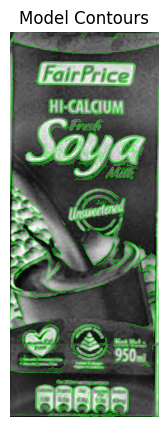

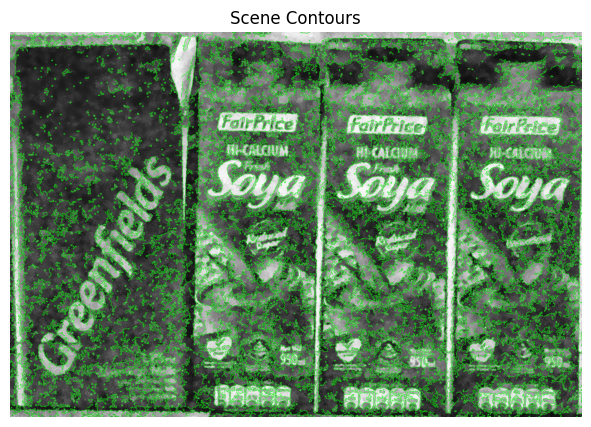


Processing inner loop:   0%|          | 4583/1588860 [00:01<10:54, 2421.75it/s]

In [ ]:
from collections import defaultdict

def preprocess_image_model(image):
    """Convert to grayscale, apply blur, and enhance contrast for the model."""
    # Convert to grayscale if the image is not already grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred_image = cv2.GaussianBlur(gray_image, (3, 3), 0)  # Use a larger kernel to reduce noise more effectively

    # Apply adaptive histogram equalization to improve contrast while reducing over-enhancement
    clahe = cv2.createCLAHE(clipLimit=3.5, tileGridSize=(8, 8))
    enhanced_image = clahe.apply(blurred_image)
    
    inverted_image = cv2.bitwise_not(enhanced_image)

    return inverted_image

def compute_keypoints(image, add_left_right_edges=False):
    # Use Canny edge detection to find edges
    edges = cv2.Canny(image, 50, 150)

    # Optionally add edge points to the left and right borders
    if add_left_right_edges:
        height, width = edges.shape
        for y in range(height):
            edges[y, 0] = 255  # Left border
            edges[y, width - 1] = 255  # Right border

    # Find contours (keypoints)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    return contours

def compute_max_min_scale(model, scene):
    model_height = model.shape[0]
    scene_height = scene.shape[0]

    max_scale = scene_height / model_height # scales down model height same as scene height
    min_scale = max_scale*0.7

    return max_scale, min_scale

def build_r_table(model_preprocessed, reference_point, scales, verbose):
    """Builds the R-table for the given model at multiple scales."""
    r_table = defaultdict(list)

    contours = compute_keypoints(model_preprocessed)

    # Plot the contours
    if verbose:
        model_contours = cv2.cvtColor(model_preprocessed, cv2.COLOR_GRAY2BGR)
        cv2.drawContours(model_contours, contours, -1, (0, 255, 0), 1)
        plt.figure(figsize=(10, 5))
        plt.title("Model Contours")
        plt.imshow(model_contours, cmap='gray')
        plt.axis('off')
        plt.show()

    grad_x = cv2.Sobel(model_preprocessed, cv2.CV_64F, 1, 0, ksize=5)
    grad_y = cv2.Sobel(model_preprocessed, cv2.CV_64F, 0, 1, ksize=5)
    gradient_direction = np.degrees(np.arctan2(grad_y, grad_x))

    # Iterate over all contours to compute vectors to the reference point for different scales
    for scale in scales:
        for contour in contours:
            for point in contour:
                pt = point[0]

                # Calculate the vector from the edge point to the reference point
                scaled_vector = (reference_point - pt) * scale
                # Calculate the gradient direction (angle) of the edge at this point
                angle = gradient_direction[pt[1], pt[0]]
                # Discretize the angle to 5-degree bins
                angle_bin = int(angle // 10) * 10
                # Store the vector in the R-table using the gradient angle bin and scale as the key
                r_table[(angle_bin, scale)].append(scaled_vector)

    return r_table

def non_maximum_suppression(boxes, scores, iou_threshold=0.5):
    """Perform Non-Maximum Suppression (NMS) on the bounding boxes.

    Args:
        boxes (list of tuples): A list of bounding boxes, where each box is represented as (x1, y1, x2, y2).
        scores (list of float): The confidence scores for each bounding box.
        iou_threshold (float): The Intersection Over Union (IoU) threshold for suppressing overlapping boxes.

    Returns:
        list: The indices of the boxes to keep after NMS.
    """
    if len(boxes) == 0:
        return []

    # Convert bounding boxes to numpy arrays for easier manipulation
    boxes = np.array(boxes)
    scores = np.array(scores)

    # Extract coordinates
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]

    # Compute the area of each bounding box
    areas = (x2 - x1 + 1) * (y2 - y1 + 1)

    # Sort boxes by scores in descending order
    order = scores.argsort()[::-1]

    keep = []

    while len(order) > 0:
        i = order[0]  # Index of the box with the highest score
        keep.append(i)

        # Compute IoU of the kept box with all other boxes
        xx1 = np.maximum(x1[i], x1[order[1:]])
        yy1 = np.maximum(y1[i], y1[order[1:]])
        xx2 = np.minimum(x2[i], x2[order[1:]])
        yy2 = np.minimum(y2[i], y2[order[1:]])

        # Compute width and height of overlapping area
        w = np.maximum(0, xx2 - xx1 + 1)
        h = np.maximum(0, yy2 - yy1 + 1)

        # Compute the Intersection Over Union (IoU)
        inter = w * h
        union = areas[i] + areas[order[1:]] - inter
        iou = inter / union

        # Keep indices of boxes with IoU less than the threshold
        remaining_indices = np.where(iou <= iou_threshold)[0]
        order = order[remaining_indices + 1]  # Shift indices by 1 to account for the removed box

    return keep


def multiple_object_retrieve(model, scene, config, verbose=False):
    # Preprocess model and scene differently for edge detection consistency
    model_preprocessed = preprocess_image_model(model)
    scene_preprocessed = preprocess_image_scene(scene)

    grad_x = cv2.Sobel(scene_preprocessed, cv2.CV_64F, 1, 0, ksize=5)
    grad_y = cv2.Sobel(scene_preprocessed, cv2.CV_64F, 0, 1, ksize=5)
    gradient_direction = np.degrees(np.arctan2(grad_y, grad_x))

    # Step 1: Edge detection using Canny for scene
    contours = compute_keypoints(scene_preprocessed)

    # Step 2: Build R-table for the model (off-line phase)
    height, width = model.shape[:2]
    model_centroid = np.array([width // 2, height // 2])
    max_scale, min_scale = compute_max_min_scale(model, scene)
    scales = np.linspace(min_scale, max_scale, config['num_scales'])
    r_table = build_r_table(model_preprocessed, model_centroid, scales, verbose)

    # Step 3: Initialize the accumulator (3D to include scales)
    accumulator = np.zeros((scene.shape[0], scene.shape[1], len(scales)), dtype=np.int32)

    # Plot the contours of the scene
    if verbose:
        scene_contours = cv2.cvtColor(scene_preprocessed, cv2.COLOR_GRAY2BGR)
        cv2.drawContours(scene_contours, contours, -1, (0, 255, 0), 1)
        plt.figure(figsize=(10, 5))
        plt.title("Scene Contours")
        plt.imshow(scene_contours, cmap='gray')
        plt.axis('off')
        plt.show()

    if verbose:
        total_inner_loops = sum(len(contour) for contour in contours) * len(scales)
        progress_bar = tqdm(total=total_inner_loops, desc="Processing inner loop")

    for contour in contours:
        for point in contour:
            pt = point[0]
            # Calculate gradient direction at the edge point in the scene
            for scale_idx, scale in enumerate(scales):
                angle = gradient_direction[pt[1], pt[0]]
                angle_bin = int(angle // 10) * 10

                # Look up the R-table for vectors corresponding to this gradient direction and scale
                if (angle_bin, scale) in r_table:
                    vectors = np.array(r_table[(angle_bin, scale)])  # shape (n, 2)

                    # Calculate the predicted positions
                    predicted_positions = vectors + np.array(pt)  # shape (n, 2)

                    # Separate x and y predicted positions
                    predicted_x, predicted_y = predicted_positions[:, 0].astype(int), predicted_positions[:, 1].astype(int)

                    # Filter out-of-bound indices
                    valid_indices = (
                        (0 <= predicted_x) & (predicted_x < scene.shape[1]) &
                        (0 <= predicted_y) & (predicted_y < scene.shape[0])
                    )

                    # Get valid predicted x and y positions
                    valid_x = predicted_x[valid_indices]
                    valid_y = predicted_y[valid_indices]

                    # Use numpy advanced indexing to update the accumulator
                    accumulator[valid_y, valid_x, scale_idx] += 1

                # Update the progress bar for each completed innermost loop step
                if verbose:
                    progress_bar.update(1)

    # Step 5: Plot the accumulator (R-table visualization)

    # Step 5: Plot the accumulator (3D scatter plot visualization)
    if verbose:
        accumulator_max = np.max(accumulator, axis=2)
        y_indices, x_indices = np.indices(accumulator_max.shape)
        z_values = accumulator_max.flatten()
        x_values = x_indices.flatten()
        y_values = y_indices.flatten()

        # Filter out zero values to only plot significant peaks
        non_zero_indices = z_values > 0
        x_values = x_values[non_zero_indices]
        y_values = y_values[non_zero_indices]
        z_values = z_values[non_zero_indices]

        fig = plt.figure(figsize=(10, 7))
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(x_values, y_values, z_values, c=z_values, cmap='hot', marker='o')
        ax.set_title("3D Accumulator after voting")
        ax.set_xlabel("X (Scene Width)")
        ax.set_ylabel("Y (Scene Height)")
        ax.set_zlabel("Votes")
        plt.show()

    # Step 6: Find peaks in the accumulator (detect multiple instances)
    # Use a threshold to determine significant peaks in the accumulator
        # Normalize the accumulator array
    accumulator = accumulator / np.max(accumulator)
    detected_positions = np.where(accumulator > config["occurrence_threshold"])

    # Draw the detected positions on the scene
    scene_boxed = scene.copy()
    found_flag = False
    num_occurrences = 0

    height, width = model.shape[:2]
    for y, x, scale_idx in zip(*detected_positions):
        scale = scales[scale_idx]
        scaled_height, scaled_width = int(height * scale), int(width * scale)

        # Correct bounding box coordinates
        top_left = (x - scaled_width // 2, y - scaled_height // 2)
        bottom_right = (x + scaled_width // 2, y + scaled_height // 2)

        # Ensure the bounding box coordinates are within bounds of the scene
        if (
            top_left[0] >= 0 and top_left[1] >= 0 and
            bottom_right[0] < scene.shape[1] and bottom_right[1] < scene.shape[0]
        ):
            # Extract the region of interest (ROI) from the scene
            roi = scene[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
            roi_resized = cv2.resize(roi, (width, height))

            # Check if the region matches the model using the ZNCC threshold
            if zncc(model, roi_resized) > config["zncc_threshold"]:
                # Draw the bounding box on the scene
                cv2.rectangle(scene_boxed, top_left, bottom_right, (0, 255, 0), thickness=3)
                num_occurrences += 1
                found_flag = True

    return found_flag, scene_boxed, num_occurrences

def multiple_object_retrieve_w_nms(model, scene, config, verbose=False, use_zncc=False, use_palette=False, use_ssim=False, use_histogram_comparison=False):
    # Preprocess model and scene differently for edge detection consistency
    model_preprocessed = preprocess_image_model(model)
    scene_preprocessed = preprocess_image_scene(scene)

    grad_x = cv2.Sobel(scene_preprocessed, cv2.CV_64F, 1, 0, ksize=5)
    grad_y = cv2.Sobel(scene_preprocessed, cv2.CV_64F, 0, 1, ksize=5)
    gradient_direction = np.degrees(np.arctan2(grad_y, grad_x))

    # Step 1: Edge detection using Canny for scene
    contours = compute_keypoints(scene_preprocessed)

    # Step 2: Build R-table for the model (off-line phase)
    height, width = model.shape[:2]
    model_centroid = np.array([width // 2, height // 2])
    max_scale, min_scale = compute_max_min_scale(model, scene)
    scales = np.linspace(min_scale, max_scale, config['num_scales'])
    r_table = build_r_table(model_preprocessed, model_centroid, scales, verbose)

    # Step 3: Initialize the accumulator (3D to include scales)
    accumulator = np.zeros((scene.shape[0], scene.shape[1], len(scales)), dtype=np.int32)

    # Plot the contours of the scene
    if verbose:
        scene_contours = cv2.cvtColor(scene_preprocessed, cv2.COLOR_GRAY2BGR)
        cv2.drawContours(scene_contours, contours, -1, (0, 255, 0), 1)
        plt.figure(figsize=(10, 5))
        plt.title("Scene Contours")
        plt.imshow(scene_contours, cmap='gray')
        plt.axis('off')
        plt.show()

    if verbose:
        total_inner_loops = sum(len(contour) for contour in contours) * len(scales)
        progress_bar = tqdm(total=total_inner_loops, desc="Processing inner loop")

    for contour in contours:
        for point in contour:
            pt = point[0]
            # Calculate gradient direction at the edge point in the scene
            for scale_idx, scale in enumerate(scales):
                angle = gradient_direction[pt[1], pt[0]]
                angle_bin = int(angle // 10) * 10

                # Look up the R-table for vectors corresponding to this gradient direction and scale
                if (angle_bin, scale) in r_table:
                    vectors = np.array(r_table[(angle_bin, scale)])  # shape (n, 2)

                    # Calculate the predicted positions
                    predicted_positions = vectors + np.array(pt)  # shape (n, 2)

                    # Separate x and y predicted positions
                    predicted_x, predicted_y = predicted_positions[:, 0].astype(int), predicted_positions[:, 1].astype(int)

                    # Filter out-of-bound indices
                    valid_indices = (
                        (0 <= predicted_x) & (predicted_x < scene.shape[1]) &
                        (0 <= predicted_y) & (predicted_y < scene.shape[0])
                    )

                    # Get valid predicted x and y positions
                    valid_x = predicted_x[valid_indices]
                    valid_y = predicted_y[valid_indices]

                    # Use numpy advanced indexing to update the accumulator
                    accumulator[valid_y, valid_x, scale_idx] += 1

                # Update the progress bar for each completed innermost loop step
                if verbose:
                    progress_bar.update(1)

    # Step 5: Plot the accumulator (R-table visualization)

    # Step 5: Plot the accumulator (3D scatter plot visualization)
    if verbose:
        accumulator_max = np.max(accumulator, axis=2)
        y_indices, x_indices = np.indices(accumulator_max.shape)
        z_values = accumulator_max.flatten()
        x_values = x_indices.flatten()
        y_values = y_indices.flatten()

        # Filter out zero values to only plot significant peaks
        non_zero_indices = z_values > 0
        x_values = x_values[non_zero_indices]
        y_values = y_values[non_zero_indices]
        z_values = z_values[non_zero_indices]

        fig = plt.figure(figsize=(10, 7))
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(x_values, y_values, z_values, c=z_values, cmap='hot', marker='o')
        ax.set_title("3D Accumulator after voting")
        ax.set_xlabel("X (Scene Width)")
        ax.set_ylabel("Y (Scene Height)")
        ax.set_zlabel("Votes")
        plt.show()

    # Step 6: Find peaks in the accumulator (detect multiple instances)
    # Use a threshold to determine significant peaks in the accumulator
        # Normalize the accumulator array
    accumulator = accumulator / np.max(accumulator)
    detected_positions = np.where(accumulator > config["occurrence_threshold"])

    # Draw the detected positions on the scene
    scene_boxed = scene.copy()
    found_flag = False
    num_occurrences = 0

    bounding_boxes = []
    scores = []
    color_scores = []

    height, width = model.shape[:2]
    for y, x, scale_idx in zip(*detected_positions):
        scale = scales[scale_idx]
        scaled_height, scaled_width = int(height * scale), int(width * scale)

        # Correct bounding box coordinates
        top_left = (x - scaled_width // 2, y - scaled_height // 2)
        bottom_right = (x + scaled_width // 2, y + scaled_height // 2)

        # Ensure the bounding box coordinates are within bounds of the scene
        if (
            top_left[0] >= 0 and top_left[1] >= 0 and
            bottom_right[0] < scene.shape[1] and bottom_right[1] < scene.shape[0]
        ):

            if use_zncc:
                roi = scene[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
                roi_resized = cv2.resize(roi, (width, height))
                
                zncc_score = zncc(model, roi_resized)
                if zncc_score > config["zncc_threshold"]:
                    bounding_boxes.append((top_left[0], top_left[1], bottom_right[0], bottom_right[1]))
                    scores.append(zncc_score)
            elif use_palette:
                roi = scene[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
                roi_resized = cv2.resize(roi, (width, height))
                
                palette_model = extract_color_palette(model, num_colors=5)
                palette_scene = extract_color_palette(roi_resized, num_colors=5)
                
                color_similarity = np.sum(np.min(np.linalg.norm(palette_model[:, np.newaxis] - palette_scene, axis=2), axis=1))
                
                if color_similarity < config["color_threshold"]:
                    bounding_boxes.append((top_left[0], top_left[1], bottom_right[0], bottom_right[1]))
                    color_scores.append(color_similarity)
                    
            elif use_ssim:
                roi = scene[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
                roi_resized = cv2.resize(roi, (width, height))
                
                if roi_resized.shape[0] >= 7 and roi_resized.shape[1] >= 7:
                    ssim_score = calculate_ssim(model, roi_resized)
                    print(ssim_score)
                    if ssim_score > config["ssim_threshold"]:
                        bounding_boxes.append((top_left[0], top_left[1], bottom_right[0], bottom_right[1]))
                        scores.append(ssim_score)
                        
            elif use_histogram_comparison:
                roi = scene[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
                roi_resized = cv2.resize(roi, (width, height))
                
                hist_score = compare_histograms(model, roi_resized)
                print(hist_score)
                if hist_score > config["hist_threshold"]:
                    bounding_boxes.append((top_left[0], top_left[1], bottom_right[0], bottom_right[1]))
                    scores.append(hist_score)
                            
            else:
                bounding_boxes.append((top_left[0], top_left[1], bottom_right[0], bottom_right[1]))
                

        # Apply Non-Maximum Suppression (NMS)
        nms_indices = non_maximum_suppression(bounding_boxes, scores, iou_threshold=0.5)
        filtered_boxes = [bounding_boxes[i] for i in nms_indices]

        scene_boxed = scene.copy()
        num_occurrences = 0

        for box in filtered_boxes:
            top_left = (box[0], box[1])
            bottom_right = (box[2], box[3])
            cv2.rectangle(scene_boxed, top_left, bottom_right, (0, 255, 0), thickness=3)
            num_occurrences += 1

        found_flag = num_occurrences > 0

    return found_flag, scene_boxed, num_occurrences

def extract_color_palette(image, num_colors=5):
    # Converti l'immagine in formato RGB (OpenCV usa BGR per default)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Reshape dell'immagine in un array bidimensionale
    pixels = image_rgb.reshape(-1, 3)

    # Applica K-means clustering per trovare i colori dominanti
    kmeans = cv2.kmeans(
        data=np.float32(pixels), 
        K=num_colors, 
        bestLabels=None, 
        criteria=(cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2), 
        attempts=10, 
        flags=cv2.KMEANS_RANDOM_CENTERS
    )[2]

    # Restituisce la palette di colori
    return kmeans.astype(int)


from skimage.metrics import structural_similarity as ssim


def calculate_ssim(image1, image2):
    """# Assuming images are in color (RGB)
    score, _ = ssim(image1, image2, full=True, win_size=3, channel_axis=-1)
    return score
    """
    
    # Assuming both images are in RGB format
    channels = cv2.split(image1)
    roi_channels = cv2.split(image2)

    # Calculate SSIM for each channel and take the average
    ssim_scores = []
    for ch1, ch2 in zip(channels, roi_channels):
        if ch1.shape[0] >= 7 and ch1.shape[1] >= 7:
            score, _ = ssim(ch1, ch2, full=True, win_size=3)
            ssim_scores.append(score)
    
    return np.mean(ssim_scores) if ssim_scores else 0

def compare_histograms(image1, image2):
    # Convert both patches to HSV color space
    image1_hsv = cv2.cvtColor(image1, cv2.COLOR_BGR2HSV)
    image2_hsv = cv2.cvtColor(image2, cv2.COLOR_BGR2HSV)

    # Calculate histograms for the HSV channels
    hist1 = cv2.calcHist([image1_hsv], [0, 1], None, [50, 60], [0, 180, 0, 256])
    hist2 = cv2.calcHist([image2_hsv], [0, 1], None, [50, 60], [0, 180, 0, 256])

    # Normalize histograms
    cv2.normalize(hist1, hist1, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)
    cv2.normalize(hist2, hist2, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)

    # Compare histograms using Correlation
    similarity_score = cv2.compareHist(hist1, hist2, cv2.HISTCMP_CORREL)
    return similarity_score

def preprocess_image_scene(image):
    """Convert to grayscale and apply blur for the scene."""
    # Convert to grayscale if the image is not already grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Apply Gaussian blur to reduce noise
    blurred_image = cv2.GaussianBlur(gray_image, (3, 3), 0)

    # Apply adaptive histogram equalization to improve contrast while reducing over-enhancement
    clahe = cv2.createCLAHE(clipLimit=2, tileGridSize=(8, 8))
    enhanced_image = clahe.apply(blurred_image)
    
    inverted_image = cv2.bitwise_not(enhanced_image)

    return inverted_image

# Configuration for edge-based GHT
config_edge_based = {
    "occurrence_threshold": 0.40,   # Threshold required to consider a point as a detection [0-1]
    "num_scales": 5,                # Number of scales to use

    "zncc_threshold": 0.65,
    "ssim_threshold": 0.87,
    "hist_threshold": 0.39,
    "color_threshold": 10
}

# Example usage
scene = denoised_scenes_multiple_instances[5]   # 6, 5, 2, 3
model = models_multiple_instances[8]            # 3, 8, 3, 0
found, scene_boxed, n_occurrences = multiple_object_retrieve_w_nms(model, scene, config_edge_based, verbose=True, use_zncc=False, use_palette=False, use_ssim=True, use_histogram_comparison=False)

# Display the final result
show_multiple_images([model, scene_boxed])


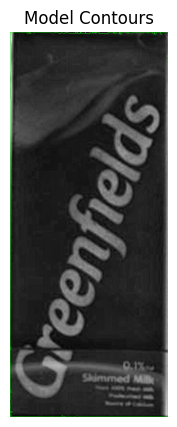

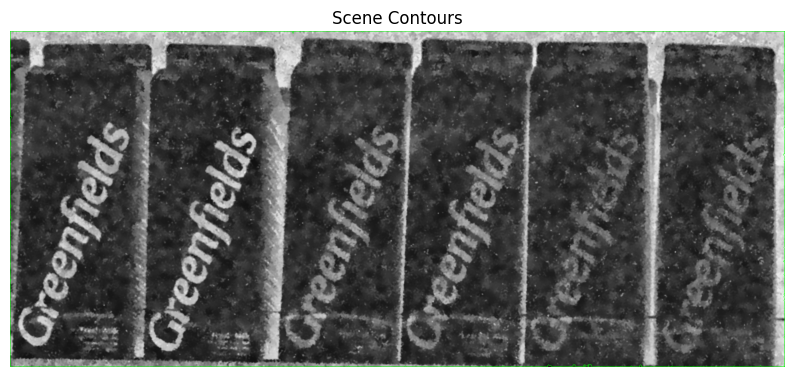

Processing inner loop:  96%|█████████▌| 22962/23930 [00:02<00:00, 13481.64it/s]

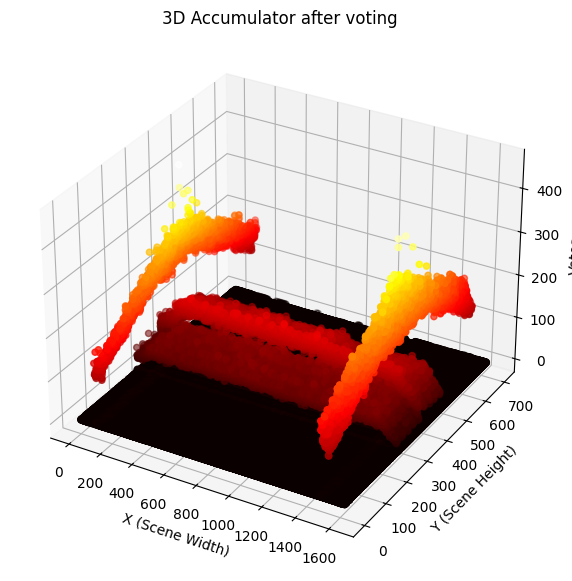

0.802967190092544
0.7862816735406781
0.8034388741748372
0.7875394204023389
0.8037808484866673
0.7887812492342139
0.8042221689676282
0.7901039000161741
0.804850858672654
0.7911730084230956
0.805676097737865
0.792034619782528
0.8065225984391787
0.7927311207704598
0.8071282691679716
0.7934563751072595
0.8077294174105975
0.7942681717039314
0.8083982395263115
0.7950183239605776
0.8090504963951854
0.7957169422745781
0.8096822192419263
0.7965526786875956
0.8103458499057826
0.7975323991014015
0.8110441274742562
0.7984962734007385
0.8117849785314695
0.7994134517979878
0.8125195979388216
0.8001158484701741
0.8131264079659609
0.8005568365393171
0.8137269724845418
0.8008287207635617
0.8143095973972856
0.8009834679147211
0.8148443708102012
0.8010770084831709
0.8155278120098778
0.8013694301866959
0.8163170814157588
0.8020597367540371
0.8170492741407052
0.8029065297013775
0.8176926057834041
0.8037431666701514
0.8182572577164633
0.8046214456088302
0.8187418504656657
0.8056882007162978
0.81921864094577

Processing inner loop: 100%|██████████| 23930/23930 [00:19<00:00, 13481.64it/s]

0.7950999815633314
0.8148907786495881
0.8209338843936548
0.7976372986225048
0.7956095506785031
0.815355896548475
0.821064193879334
0.7983163684095117
0.7961262506786103
0.8158380948055219
0.8210878288451987
0.7990773207253472
0.7966849820627311
0.8161904748272365
0.8212167893643322
0.7998797888383583
0.7972889380841067
0.8161938523218265
0.8213883687537326
0.8006720840459237
0.7978785237052849
0.8159581229933922
0.8215036582859329
0.801382101144208
0.7984970133963042
0.815928253913475
0.8215111047301494
0.8019681159778823
0.799155592295536
0.8160493695613686
0.8214221309673144
0.8024665458918445
0.7998713528090365
0.8163572770179774
0.8212837730524706
0.8030349019057993
0.8005919240427186
0.8167161110429993
0.821244977307745
0.8037146402769046
0.8013346201738468
0.8168215259435074
0.8213180412358186
0.8042826600513778
0.8020857886558731
0.8166995745126434
0.8215012417038334
0.8047900921581584
0.80283146644947
0.8165406459345487
0.8216612767855818
0.805286177209978
0.8035707797748315
0.

KeyboardInterrupt: 

In [34]:
from collections import defaultdict

def preprocess_image_model(image):
    """Convert to grayscale, apply blur, and enhance contrast for the model."""
    # Convert to grayscale if the image is not already grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred_image = cv2.GaussianBlur(gray_image, (3, 3), 0)  # Use a larger kernel to reduce noise more effectively

    # Apply adaptive histogram equalization to improve contrast while reducing over-enhancement
    clahe = cv2.createCLAHE(clipLimit=3.5, tileGridSize=(8, 8))
    enhanced_image = clahe.apply(blurred_image)
    
    inverted_image = cv2.bitwise_not(enhanced_image)

    return inverted_image

def compute_keypoints(image):   
    # Use Canny edge detection to find edges
    edges_laplacian = cv2.Laplacian(image, cv2.CV_64F, ksize=3)
    edges_laplacian = cv2.convertScaleAbs(edges_laplacian)
    edges_canny = cv2.Canny(image, 50, 150)
    edges = cv2.bitwise_or(edges_canny, edges_laplacian)

    # Find contours (keypoints)
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    return contours

def compute_max_min_scale(model, scene):
    model_height = model.shape[0]
    scene_height = scene.shape[0]

    max_scale = scene_height / model_height # scales down model height same as scene height
    min_scale = max_scale*0.7

    return max_scale, min_scale

def build_r_table(model_preprocessed, reference_point, scales, verbose):
    """Builds the R-table for the given model at multiple scales."""
    r_table = defaultdict(list)

    contours = compute_keypoints(model_preprocessed)

    # Plot the contours
    if verbose:
        model_contours = cv2.cvtColor(model_preprocessed, cv2.COLOR_GRAY2BGR)
        cv2.drawContours(model_contours, contours, -1, (0, 255, 0), 1)
        plt.figure(figsize=(10, 5))
        plt.title("Model Contours")
        plt.imshow(model_contours, cmap='gray')
        plt.axis('off')
        plt.show()

    grad_x = cv2.Sobel(model_preprocessed, cv2.CV_64F, 1, 0, ksize=5)
    grad_y = cv2.Sobel(model_preprocessed, cv2.CV_64F, 0, 1, ksize=5)
    gradient_direction = np.degrees(np.arctan2(grad_y, grad_x))

    # Iterate over all contours to compute vectors to the reference point for different scales
    for scale in scales:
        for contour in contours:
            for point in contour:
                pt = point[0]

                # Calculate the vector from the edge point to the reference point
                scaled_vector = (reference_point - pt) * scale
                # Calculate the gradient direction (angle) of the edge at this point
                angle = gradient_direction[pt[1], pt[0]]
                # Discretize the angle to 5-degree bins
                angle_bin = int(angle // 10) * 10
                # Store the vector in the R-table using the gradient angle bin and scale as the key
                r_table[(angle_bin, scale)].append(scaled_vector)

    return r_table

def non_maximum_suppression(boxes, scores, iou_threshold=0.5):
    """Perform Non-Maximum Suppression (NMS) on the bounding boxes.

    Args:
        boxes (list of tuples): A list of bounding boxes, where each box is represented as (x1, y1, x2, y2).
        scores (list of float): The confidence scores for each bounding box.
        iou_threshold (float): The Intersection Over Union (IoU) threshold for suppressing overlapping boxes.

    Returns:
        list: The indices of the boxes to keep after NMS.
    """
    if len(boxes) == 0:
        return []

    # Convert bounding boxes to numpy arrays for easier manipulation
    boxes = np.array(boxes)
    scores = np.array(scores)

    # Extract coordinates
    x1 = boxes[:, 0]
    y1 = boxes[:, 1]
    x2 = boxes[:, 2]
    y2 = boxes[:, 3]

    # Compute the area of each bounding box
    areas = (x2 - x1 + 1) * (y2 - y1 + 1)

    # Sort boxes by scores in descending order
    order = scores.argsort()[::-1]

    keep = []

    while len(order) > 0:
        i = order[0]  # Index of the box with the highest score
        keep.append(i)

        # Compute IoU of the kept box with all other boxes
        xx1 = np.maximum(x1[i], x1[order[1:]])
        yy1 = np.maximum(y1[i], y1[order[1:]])
        xx2 = np.minimum(x2[i], x2[order[1:]])
        yy2 = np.minimum(y2[i], y2[order[1:]])

        # Compute width and height of overlapping area
        w = np.maximum(0, xx2 - xx1 + 1)
        h = np.maximum(0, yy2 - yy1 + 1)

        # Compute the Intersection Over Union (IoU)
        inter = w * h
        union = areas[i] + areas[order[1:]] - inter
        iou = inter / union

        # Keep indices of boxes with IoU less than the threshold
        remaining_indices = np.where(iou <= iou_threshold)[0]
        order = order[remaining_indices + 1]  # Shift indices by 1 to account for the removed box

    return keep


def multiple_object_retrieve(model, scene, config, verbose=False):
    # Preprocess model and scene differently for edge detection consistency
    model_preprocessed = preprocess_image_model(model)
    scene_preprocessed = preprocess_image_scene(scene)

    grad_x = cv2.Sobel(scene_preprocessed, cv2.CV_64F, 1, 0, ksize=5)
    grad_y = cv2.Sobel(scene_preprocessed, cv2.CV_64F, 0, 1, ksize=5)
    gradient_direction = np.degrees(np.arctan2(grad_y, grad_x))

    # Step 1: Edge detection using Canny for scene
    contours = compute_keypoints(scene_preprocessed)

    # Step 2: Build R-table for the model (off-line phase)
    height, width = model.shape[:2]
    model_centroid = np.array([width // 2, height // 2])
    max_scale, min_scale = compute_max_min_scale(model, scene)
    scales = np.linspace(min_scale, max_scale, config['num_scales'])
    r_table = build_r_table(model_preprocessed, model_centroid, scales, verbose)

    # Step 3: Initialize the accumulator (3D to include scales)
    accumulator = np.zeros((scene.shape[0], scene.shape[1], len(scales)), dtype=np.int32)

    # Plot the contours of the scene
    if verbose:
        scene_contours = cv2.cvtColor(scene_preprocessed, cv2.COLOR_GRAY2BGR)
        cv2.drawContours(scene_contours, contours, -1, (0, 255, 0), 1)
        plt.figure(figsize=(10, 5))
        plt.title("Scene Contours")
        plt.imshow(scene_contours, cmap='gray')
        plt.axis('off')
        plt.show()

    if verbose:
        total_inner_loops = sum(len(contour) for contour in contours) * len(scales)
        progress_bar = tqdm(total=total_inner_loops, desc="Processing inner loop")

    for contour in contours:
        for point in contour:
            pt = point[0]
            # Calculate gradient direction at the edge point in the scene
            for scale_idx, scale in enumerate(scales):
                angle = gradient_direction[pt[1], pt[0]]
                angle_bin = int(angle // 10) * 10

                # Look up the R-table for vectors corresponding to this gradient direction and scale
                if (angle_bin, scale) in r_table:
                    vectors = np.array(r_table[(angle_bin, scale)])  # shape (n, 2)

                    # Calculate the predicted positions
                    predicted_positions = vectors + np.array(pt)  # shape (n, 2)

                    # Separate x and y predicted positions
                    predicted_x, predicted_y = predicted_positions[:, 0].astype(int), predicted_positions[:, 1].astype(int)

                    # Filter out-of-bound indices
                    valid_indices = (
                        (0 <= predicted_x) & (predicted_x < scene.shape[1]) &
                        (0 <= predicted_y) & (predicted_y < scene.shape[0])
                    )

                    # Get valid predicted x and y positions
                    valid_x = predicted_x[valid_indices]
                    valid_y = predicted_y[valid_indices]

                    # Use numpy advanced indexing to update the accumulator
                    accumulator[valid_y, valid_x, scale_idx] += 1

                # Update the progress bar for each completed innermost loop step
                if verbose:
                    progress_bar.update(1)

    # Step 5: Plot the accumulator (R-table visualization)

    # Step 5: Plot the accumulator (3D scatter plot visualization)
    if verbose:
        accumulator_max = np.max(accumulator, axis=2)
        y_indices, x_indices = np.indices(accumulator_max.shape)
        z_values = accumulator_max.flatten()
        x_values = x_indices.flatten()
        y_values = y_indices.flatten()

        # Filter out zero values to only plot significant peaks
        non_zero_indices = z_values > 0
        x_values = x_values[non_zero_indices]
        y_values = y_values[non_zero_indices]
        z_values = z_values[non_zero_indices]

        fig = plt.figure(figsize=(10, 7))
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(x_values, y_values, z_values, c=z_values, cmap='hot', marker='o')
        ax.set_title("3D Accumulator after voting")
        ax.set_xlabel("X (Scene Width)")
        ax.set_ylabel("Y (Scene Height)")
        ax.set_zlabel("Votes")
        plt.show()

    # Step 6: Find peaks in the accumulator (detect multiple instances)
    # Use a threshold to determine significant peaks in the accumulator
        # Normalize the accumulator array
    accumulator = accumulator / np.max(accumulator)
    detected_positions = np.where(accumulator > config["occurrence_threshold"])

    # Draw the detected positions on the scene
    scene_boxed = scene.copy()
    found_flag = False
    num_occurrences = 0

    height, width = model.shape[:2]
    for y, x, scale_idx in zip(*detected_positions):
        scale = scales[scale_idx]
        scaled_height, scaled_width = int(height * scale), int(width * scale)

        # Correct bounding box coordinates
        top_left = (x - scaled_width // 2, y - scaled_height // 2)
        bottom_right = (x + scaled_width // 2, y + scaled_height // 2)

        # Ensure the bounding box coordinates are within bounds of the scene
        if (
            top_left[0] >= 0 and top_left[1] >= 0 and
            bottom_right[0] < scene.shape[1] and bottom_right[1] < scene.shape[0]
        ):
            # Extract the region of interest (ROI) from the scene
            roi = scene[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
            roi_resized = cv2.resize(roi, (width, height))

            # Check if the region matches the model using the ZNCC threshold
            if zncc(model, roi_resized) > config["zncc_threshold"]:
                # Draw the bounding box on the scene
                cv2.rectangle(scene_boxed, top_left, bottom_right, (0, 255, 0), thickness=3)
                num_occurrences += 1
                found_flag = True

    return found_flag, scene_boxed, num_occurrences

def multiple_object_retrieve_w_nms(model, scene, config, verbose=False, use_zncc=False, use_palette=False, use_ssim=False, use_histogram_comparison=False):
    # Preprocess model and scene differently for edge detection consistency
    model_preprocessed = preprocess_image_model(model)
    scene_preprocessed = preprocess_image_scene(scene)

    grad_x = cv2.Sobel(scene_preprocessed, cv2.CV_64F, 1, 0, ksize=5)
    grad_y = cv2.Sobel(scene_preprocessed, cv2.CV_64F, 0, 1, ksize=5)
    gradient_direction = np.degrees(np.arctan2(grad_y, grad_x))

    # Step 1: Edge detection using Canny for scene
    contours = compute_keypoints(scene_preprocessed)

    # Step 2: Build R-table for the model (off-line phase)
    height, width = model.shape[:2]
    model_centroid = np.array([width // 2, height // 2])
    max_scale, min_scale = compute_max_min_scale(model, scene)
    scales = np.linspace(min_scale, max_scale, config['num_scales'])
    r_table = build_r_table(model_preprocessed, model_centroid, scales, verbose)

    # Step 3: Initialize the accumulator (3D to include scales)
    accumulator = np.zeros((scene.shape[0], scene.shape[1], len(scales)), dtype=np.int32)

    # Plot the contours of the scene
    if verbose:
        scene_contours = cv2.cvtColor(scene_preprocessed, cv2.COLOR_GRAY2BGR)
        cv2.drawContours(scene_contours, contours, -1, (0, 255, 0), 1)
        plt.figure(figsize=(10, 5))
        plt.title("Scene Contours")
        plt.imshow(scene_contours, cmap='gray')
        plt.axis('off')
        plt.show()

    if verbose:
        total_inner_loops = sum(len(contour) for contour in contours) * len(scales)
        progress_bar = tqdm(total=total_inner_loops, desc="Processing inner loop")

    for contour in contours:
        for point in contour:
            pt = point[0]
            # Calculate gradient direction at the edge point in the scene
            for scale_idx, scale in enumerate(scales):
                angle = gradient_direction[pt[1], pt[0]]
                angle_bin = int(angle // 10) * 10

                # Look up the R-table for vectors corresponding to this gradient direction and scale
                if (angle_bin, scale) in r_table:
                    vectors = np.array(r_table[(angle_bin, scale)])  # shape (n, 2)

                    # Calculate the predicted positions
                    predicted_positions = vectors + np.array(pt)  # shape (n, 2)

                    # Separate x and y predicted positions
                    predicted_x, predicted_y = predicted_positions[:, 0].astype(int), predicted_positions[:, 1].astype(int)

                    # Filter out-of-bound indices
                    valid_indices = (
                        (0 <= predicted_x) & (predicted_x < scene.shape[1]) &
                        (0 <= predicted_y) & (predicted_y < scene.shape[0])
                    )

                    # Get valid predicted x and y positions
                    valid_x = predicted_x[valid_indices]
                    valid_y = predicted_y[valid_indices]

                    # Use numpy advanced indexing to update the accumulator
                    accumulator[valid_y, valid_x, scale_idx] += 1

                # Update the progress bar for each completed innermost loop step
                if verbose:
                    progress_bar.update(1)

    # Step 5: Plot the accumulator (R-table visualization)

    # Step 5: Plot the accumulator (3D scatter plot visualization)
    if verbose:
        accumulator_max = np.max(accumulator, axis=2)
        y_indices, x_indices = np.indices(accumulator_max.shape)
        z_values = accumulator_max.flatten()
        x_values = x_indices.flatten()
        y_values = y_indices.flatten()

        # Filter out zero values to only plot significant peaks
        non_zero_indices = z_values > 0
        x_values = x_values[non_zero_indices]
        y_values = y_values[non_zero_indices]
        z_values = z_values[non_zero_indices]

        fig = plt.figure(figsize=(10, 7))
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(x_values, y_values, z_values, c=z_values, cmap='hot', marker='o')
        ax.set_title("3D Accumulator after voting")
        ax.set_xlabel("X (Scene Width)")
        ax.set_ylabel("Y (Scene Height)")
        ax.set_zlabel("Votes")
        plt.show()

    # Step 6: Find peaks in the accumulator (detect multiple instances)
    # Use a threshold to determine significant peaks in the accumulator
        # Normalize the accumulator array
    accumulator = accumulator / np.max(accumulator)
    detected_positions = np.where(accumulator > config["occurrence_threshold"])

    # Draw the detected positions on the scene
    scene_boxed = scene.copy()
    found_flag = False
    num_occurrences = 0

    bounding_boxes = []
    scores = []
    color_scores = []

    height, width = model.shape[:2]
    for y, x, scale_idx in zip(*detected_positions):
        scale = scales[scale_idx]
        scaled_height, scaled_width = int(height * scale), int(width * scale)

        # Correct bounding box coordinates
        top_left = (x - scaled_width // 2, y - scaled_height // 2)
        bottom_right = (x + scaled_width // 2, y + scaled_height // 2)

        # Ensure the bounding box coordinates are within bounds of the scene
        if (
            top_left[0] >= 0 and top_left[1] >= 0 and
            bottom_right[0] < scene.shape[1] and bottom_right[1] < scene.shape[0]
        ):

            if use_zncc:
                roi = scene[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
                roi_resized = cv2.resize(roi, (width, height))
                
                zncc_score = zncc(model, roi_resized)
                if zncc_score > config["zncc_threshold"]:
                    bounding_boxes.append((top_left[0], top_left[1], bottom_right[0], bottom_right[1]))
                    scores.append(zncc_score)
            elif use_palette:
                roi = scene[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
                roi_resized = cv2.resize(roi, (width, height))
                
                palette_model = extract_color_palette(model, num_colors=5)
                palette_scene = extract_color_palette(roi_resized, num_colors=5)
                
                color_similarity = np.sum(np.min(np.linalg.norm(palette_model[:, np.newaxis] - palette_scene, axis=2), axis=1))
                
                if color_similarity < config["color_threshold"]:
                    bounding_boxes.append((top_left[0], top_left[1], bottom_right[0], bottom_right[1]))
                    color_scores.append(color_similarity)
                    
            elif use_ssim:
                roi = scene[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
                roi_resized = cv2.resize(roi, (width, height))
                
                if roi_resized.shape[0] >= 7 and roi_resized.shape[1] >= 7:
                    ssim_score = calculate_ssim(model, roi_resized)
                    print(ssim_score)
                    if ssim_score > config["ssim_threshold"]:
                        bounding_boxes.append((top_left[0], top_left[1], bottom_right[0], bottom_right[1]))
                        scores.append(ssim_score)
                        
            elif use_histogram_comparison:
                roi = scene[top_left[1]:bottom_right[1], top_left[0]:bottom_right[0]]
                roi_resized = cv2.resize(roi, (width, height))
                
                hist_score = compare_histograms(model, roi_resized)
                print(hist_score)
                if hist_score > config["hist_threshold"]:
                    bounding_boxes.append((top_left[0], top_left[1], bottom_right[0], bottom_right[1]))
                    scores.append(hist_score)
                            
            else:
                bounding_boxes.append((top_left[0], top_left[1], bottom_right[0], bottom_right[1]))
                

        # Apply Non-Maximum Suppression (NMS)
        nms_indices = non_maximum_suppression(bounding_boxes, scores, iou_threshold=0.5)
        filtered_boxes = [bounding_boxes[i] for i in nms_indices]

        scene_boxed = scene.copy()
        num_occurrences = 0

        for box in filtered_boxes:
            top_left = (box[0], box[1])
            bottom_right = (box[2], box[3])
            cv2.rectangle(scene_boxed, top_left, bottom_right, (0, 255, 0), thickness=3)
            num_occurrences += 1

        found_flag = num_occurrences > 0

    return found_flag, scene_boxed, num_occurrences

def extract_color_palette(image, num_colors=5):
    # Converti l'immagine in formato RGB (OpenCV usa BGR per default)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Reshape dell'immagine in un array bidimensionale
    pixels = image_rgb.reshape(-1, 3)

    # Applica K-means clustering per trovare i colori dominanti
    kmeans = cv2.kmeans(
        data=np.float32(pixels), 
        K=num_colors, 
        bestLabels=None, 
        criteria=(cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.2), 
        attempts=10, 
        flags=cv2.KMEANS_RANDOM_CENTERS
    )[2]

    # Restituisce la palette di colori
    return kmeans.astype(int)


from skimage.metrics import structural_similarity as ssim


def calculate_ssim(image1, image2):
    """# Assuming images are in color (RGB)
    score, _ = ssim(image1, image2, full=True, win_size=3, channel_axis=-1)
    return score
    """
    
    # Assuming both images are in RGB format
    channels = cv2.split(image1)
    roi_channels = cv2.split(image2)

    # Calculate SSIM for each channel and take the average
    ssim_scores = []
    for ch1, ch2 in zip(channels, roi_channels):
        if ch1.shape[0] >= 7 and ch1.shape[1] >= 7:
            score, _ = ssim(ch1, ch2, full=True, win_size=3)
            ssim_scores.append(score)
    
    return np.mean(ssim_scores) if ssim_scores else 0

def compare_histograms(image1, image2):
    # Convert both patches to HSV color space
    image1_hsv = cv2.cvtColor(image1, cv2.COLOR_BGR2HSV)
    image2_hsv = cv2.cvtColor(image2, cv2.COLOR_BGR2HSV)

    # Calculate histograms for the HSV channels
    hist1 = cv2.calcHist([image1_hsv], [0, 1], None, [50, 60], [0, 180, 0, 256])
    hist2 = cv2.calcHist([image2_hsv], [0, 1], None, [50, 60], [0, 180, 0, 256])

    # Normalize histograms
    cv2.normalize(hist1, hist1, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)
    cv2.normalize(hist2, hist2, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)

    # Compare histograms using Correlation
    similarity_score = cv2.compareHist(hist1, hist2, cv2.HISTCMP_CORREL)
    return similarity_score

def preprocess_image_scene(image):
    """Convert to grayscale and apply blur for the scene."""
    # Convert to grayscale if the image is not already grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Apply Gaussian blur to reduce noise
    blurred_image = cv2.GaussianBlur(gray_image, (3, 3), 0)

    # Apply adaptive histogram equalization to improve contrast while reducing over-enhancement
    clahe = cv2.createCLAHE(clipLimit=2, tileGridSize=(8, 8))
    enhanced_image = clahe.apply(blurred_image)
    
    inverted_image = cv2.bitwise_not(enhanced_image)

    return inverted_image

# Configuration for edge-based GHT
config_edge_based = {
    "occurrence_threshold": 0.40,   # Threshold required to consider a point as a detection [0-1]
    "num_scales": 5,                # Number of scales to use

    "zncc_threshold": 0.65,
    "ssim_threshold": 0.87,
    "hist_threshold": 0.39,
    "color_threshold": 10
}

# Example usage
scene = denoised_scenes_multiple_instances[2]   # 6, 5, 2, 3
model = models_multiple_instances[3]            # 3, 8, 3, 0
found, scene_boxed, n_occurrences = multiple_object_retrieve_w_nms(model, scene, config_edge_based, verbose=True, use_zncc=False, use_palette=False, use_ssim=True, use_histogram_comparison=False)

# Display the final result
show_multiple_images([model, scene_boxed])


In [54]:
multi_model_scene_couples = []
multi_instance_detected_matchings = {scene: [] for scene in range(len(denoised_scenes_multiple_instances))}

total_iterations = len(models_multiple_instances) * len(denoised_scenes_multiple_instances)
with tqdm(total=total_iterations, desc="Processing Models and Scenes") as pbar:
    for model_idx, model in enumerate(models_multiple_instances):
        for scene_idx, scene in enumerate(denoised_scenes_multiple_instances):
            
            # compute matchings, update "multi_instance_detected_matchings" and "multi_model_scene_couples"
            found, scene_boxed, occurrences = multiple_object_retrieve_w_nms(model, scene, config_edge_based)
            multi_model_scene_couples.append([model, scene_boxed, found, occurrences])

            if found:
                multi_instance_detected_matchings[scene_idx].append((model_idx, occurrences))

            pbar.update(1)  # Update progress bar by one step

# After processing, summarize the detection results
print_detection_summary(multi_instance_real_matchings, multi_instance_detected_matchings)



Processing Models and Scenes: 100%|██████████| 84/84 [1:07:50<00:00, 48.46s/it]

Detection summary:
Scene 0              Models in the image: [(6, 2), (7, 2)]                        Models detected: [(6, 2), (7, 2)]
Scene 1              Models in the image: [(2, 2), (8, 2), (9, 3)]                Models detected: [(2, 2), (8, 2), (9, 2)]
Scene 2              Models in the image: [(10, 2), (11, 2), (3, 2)]              Models detected: [(10, 2), (11, 4)]
Scene 3              Models in the image: [(0, 2)]                                Models detected: []
Scene 4              Models in the image: [(1, 2)]                                Models detected: [(1, 1)]
Scene 5              Models in the image: [(11, 1), (2, 2), (8, 1)]               Models detected: [(2, 2), (8, 3)]
Scene 6              Models in the image: [(3, 2), (4, 2), (5, 2)]                Models detected: [(3, 1), (4, 2), (5, 2)]


In [ ]:
def object_retrieve(model, scene, config):
    sift = cv2.SIFT_create(contrastThreshold=config["sift_contrast_threshold"],
                           edgeThreshold=config["sift_edge_threshold"],
                           sigma=config["sift_sigma"],
                           nOctaveLayers=config["sift_n_octave_layers"])

    # Detect keypoints and compute descriptors
    keypoints_model, descriptors_model = sift.detectAndCompute(model, None)
    keypoints_scene, descriptors_scene = sift.detectAndCompute(scene, None)

    # FLANN parameters for matching
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=config["flann_trees"])
    search_params = dict(checks=config["flann_checks"])
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    # Match descriptors using k-NN (k=2)
    matches = flann.knnMatch(descriptors_model, descriptors_scene, k=5)

    # Lowe's ratio test to select good matches. m is first match, n is second match.
    good_matches = []
    for model_point, scene_point in matches:
        if model_point.distance < config["lowes_ratio_thresh"] * scene_point.distance:
            good_matches.append(model_point)

    # Ensure enough good matches were found
    if len(good_matches) < config["low_thresh_min_match"]:
        return False, scene, len(good_matches)

    # Extract coordinates from the good matches
    src_pts = np.float32([keypoints_model[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([keypoints_scene[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    # Find homography matrix
    homography, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

    # Validate using zncc
    matching_exceeds_high_threshold = len(good_matches) > config["high_thresh_min_match"]
    matching_exceeds_low_threshold = len(good_matches) > config["low_thresh_min_match"]
    patch_check_is_valid = validate_matching(model, scene, homography, config)

    if matching_exceeds_high_threshold or (matching_exceeds_low_threshold and patch_check_is_valid):
        height, width = model.shape[:2]
        model_corners = np.float32([[0, 0], [0, height - 1], [width - 1, height - 1], [width - 1, 0]]).reshape(-1, 1, 2)
        dst = cv2.perspectiveTransform(model_corners, homography)
        scene_boxed = cv2.polylines(np.array(scene), [np.int32(dst)], True, (0, 255, 0), 5, cv2.LINE_AA)

        return True, scene_boxed, len(good_matches)
    else:
        return False, scene, len(good_matches)

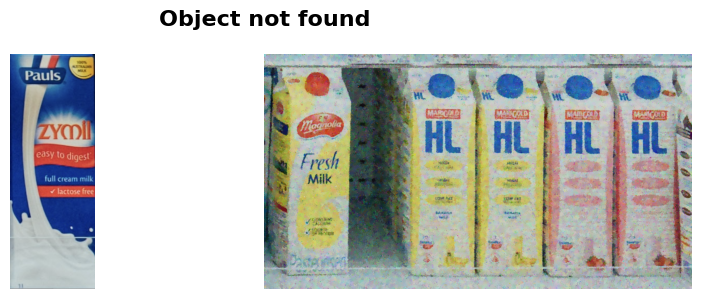

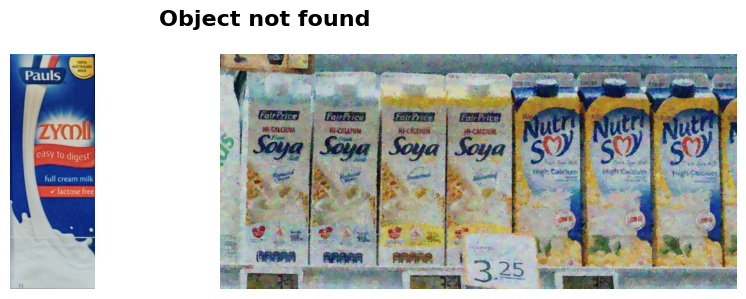

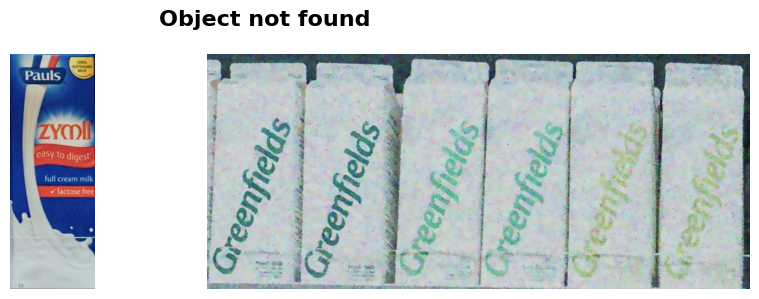

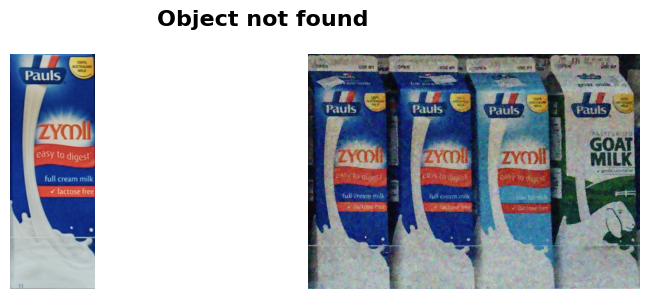

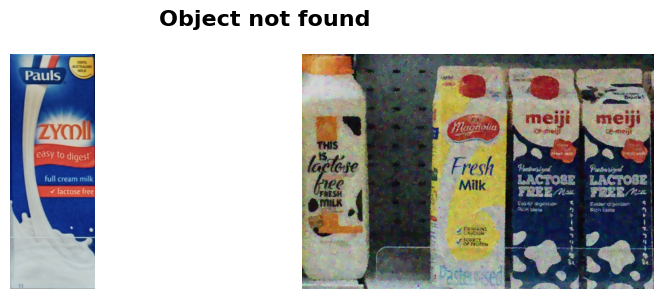

...

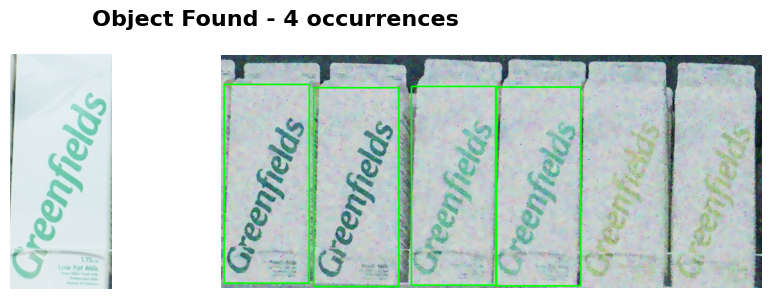

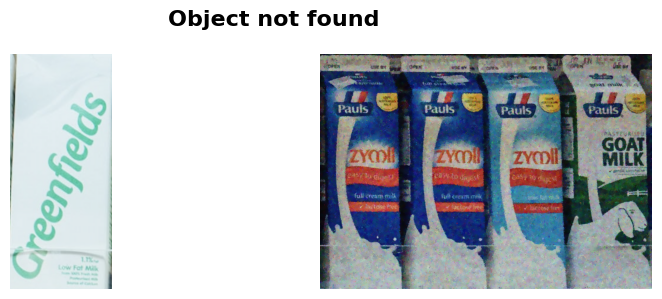

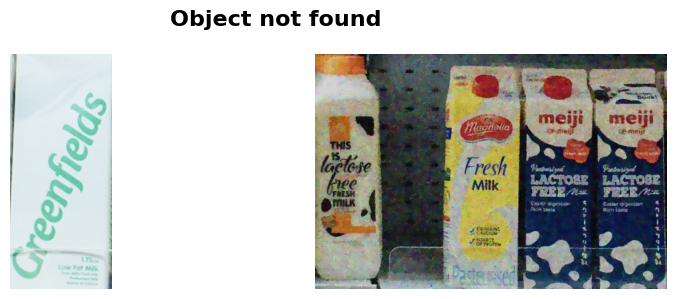

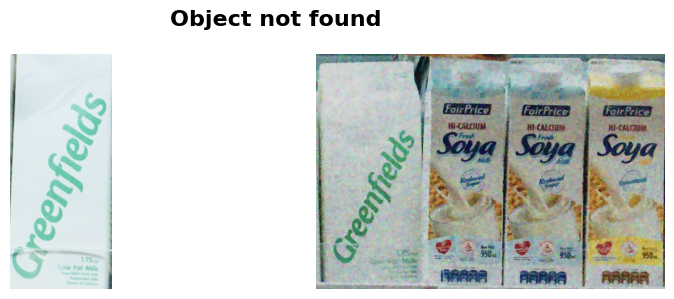

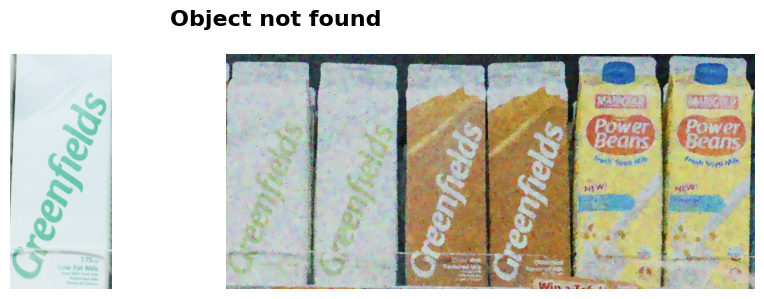

In [55]:
PLOT_ALL_IMAGES = True

if PLOT_ALL_IMAGES:
    for model, scene, found, good_matches in multi_model_scene_couples:
        if found > 0:
            show_multiple_images([model, scene], cols=2, global_title=f"Object Found - {good_matches} occurrences")
        else:
            show_multiple_images([model, scene], cols=2, global_title=f"Object not found")